In [1]:
! pip install transformers==4.37.2

In [2]:
# Import necessary libraries for MIL with ViT-B16
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from transformers import ViTModel, ViTConfig
import numpy as np
from PIL import Image
import os
import glob
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Set random seeds for reproducibility
torch.manual_seed(42)
np.random.seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed(42)

/home/pclab/miniconda3/envs/clam_latest/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using device: cuda


In [3]:
def extract_patches(image, patch_size=512, stride=256):
    """
    Extract patches of size 512x512 with stride 256, then downsample each patch to 224x224.
    
    Args:
        image: PIL Image or numpy array
        patch_size: Size of each patch (default 512)
        stride: Stride between patches (default 256)
    
    Returns:
        List of patches as PIL Images (downsampled to 224x224)
    """
    if isinstance(image, Image.Image):
        image = np.array(image)
    
    patches = []
    h, w = image.shape[:2]
    
    # Calculate number of patches in each dimension
    n_patches_h = (h - patch_size) // stride + 1
    n_patches_w = (w - patch_size) // stride + 1
    
    # If image is smaller than patch_size, pad it
    if h < patch_size or w < patch_size:
        pad_h = max(0, patch_size - h)
        pad_w = max(0, patch_size - w)
        if len(image.shape) == 3:
            image = np.pad(image, ((0, pad_h), (0, pad_w), (0, 0)), mode='constant')
        else:
            image = np.pad(image, ((0, pad_h), (0, pad_w)), mode='constant')
        h, w = image.shape[:2]
        n_patches_h = 1
        n_patches_w = 1
    
    # Extract patches and downsample
    for i in range(n_patches_h):
        for j in range(n_patches_w):
            y = i * stride
            x = j * stride
            if y + patch_size <= h and x + patch_size <= w:
                patch = image[y:y+patch_size, x:x+patch_size]
                patch_img = Image.fromarray(patch)
                patch_img = patch_img.resize((224, 224), Image.BILINEAR)
                patches.append(patch_img)
    
    # If no patches extracted (edge case), extract from top-left corner
    if not patches:
        patch = image[:patch_size, :patch_size]
        patch_img = Image.fromarray(patch)
        patch_img = patch_img.resize((224, 224), Image.BILINEAR)
        patches.append(patch_img)
    
    return patches

print("Patch extraction function updated: 512x512 patches, stride 256, downsampled to 224x224.")

Patch extraction function updated: 512x512 patches, stride 256, downsampled to 224x224.


In [4]:
class MILDataset(Dataset):
    """
    Multiple Instance Learning Dataset for histopathology images.
    Each image is treated as a bag, and patches are instances.
    """
    
    def __init__(self, image_paths, labels, transform=None, patch_size=224):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform
        self.patch_size = patch_size
        
        # Define transforms for ViT preprocessing
        if self.transform is None:
            self.transform = transforms.Compose([
                transforms.Resize((224, 224)),  # Ensure patches are exactly 224x224
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                                   std=[0.229, 0.224, 0.225])  # ImageNet normalization
            ])
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        # Load image
        image_path = self.image_paths[idx]
        label = self.labels[idx]
        
        try:
            # Load image
            image = Image.open(image_path).convert('RGB')
            
            # Extract patches
            patches = extract_patches(image, patch_size=self.patch_size)
            
            # Apply transforms to each patch
            patch_tensors = []
            for patch in patches:
                patch_tensor = self.transform(patch)
                patch_tensors.append(patch_tensor)
            
            # Stack patches into a single tensor [num_patches, 3, 224, 224]
            if patch_tensors:
                patches_tensor = torch.stack(patch_tensors)
            else:
                # Fallback: create a single patch from the entire image
                patches_tensor = self.transform(image).unsqueeze(0)
            
            return patches_tensor, torch.tensor(label, dtype=torch.long)
            
        except Exception as e:
            print(f"Error loading image {image_path}: {e}")
            # Return a dummy tensor in case of error
            dummy_patch = torch.zeros((1, 3, 224, 224))
            return dummy_patch, torch.tensor(label, dtype=torch.long)

def collate_mil_batch(batch):
    """
    Custom collate function for MIL batches.
    Each sample can have different numbers of patches.
    """
    patches_list = []
    labels_list = []
    
    for patches, label in batch:
        patches_list.append(patches)
        labels_list.append(label)
    
    # Convert labels to tensor
    labels_tensor = torch.stack(labels_list)
    
    return patches_list, labels_tensor

print("MIL Dataset class created successfully!")
print("This dataset will extract patches from each image and treat them as instances in MIL framework.")

MIL Dataset class created successfully!
This dataset will extract patches from each image and treat them as instances in MIL framework.


In [5]:
# Load pre-trained ViT-B16 model with frozen backbone for 4-class classification
print("Loading ViT-B16 model with frozen backbone...")

class ViTFeatureExtractor(nn.Module):
    """
    ViT-B16 feature extractor that outputs features for each patch.
    Pre-trained on ImageNet with frozen backbone - only classification layer is trainable.
    """
    
    def __init__(self, pretrained=True, freeze_backbone=True):
        super(ViTFeatureExtractor, self).__init__()
        
        # Load pre-trained ViT-B16 from ImageNet
        self.vit = ViTModel.from_pretrained('google/vit-base-patch16-224')
        
        # ALWAYS freeze the backbone to keep ImageNet features
        # Only the classification layer will be trainable
        print("Freezing ViT backbone (keeping ImageNet pre-trained features)...")
        for param in self.vit.parameters():
            param.requires_grad = False
        
        # Feature dimension from ViT-B16
        self.feature_dim = self.vit.config.hidden_size  # 768 for ViT-B16
        
        print(f"✓ ViT backbone frozen - {sum(1 for p in self.vit.parameters() if not p.requires_grad)} parameters frozen")
        print(f"✓ Feature dimension: {self.feature_dim}")
        
    def forward(self, x):
        """
        Forward pass through ViT.
        
        Args:
            x: Input tensor of shape [batch_size, 3, 224, 224]
        
        Returns:
            features: Tensor of shape [batch_size, feature_dim]
        """
        # Get ViT outputs (backbone is frozen, no gradients computed)
        with torch.no_grad() if not self.training else torch.enable_grad():
            outputs = self.vit(x)
        
        # Use the [CLS] token representation
        features = outputs.last_hidden_state[:, 0]  # [batch_size, 768]
        
        return features

# Initialize the ViT feature extractor with frozen backbone
vit_feature_extractor = ViTFeatureExtractor(pretrained=True, freeze_backbone=True)
vit_feature_extractor = vit_feature_extractor.to(device)

print(f"ViT-B16 model loaded successfully!")
print(f"Feature dimension: {vit_feature_extractor.feature_dim}")
print(f"Model parameters: {sum(p.numel() for p in vit_feature_extractor.parameters()):,}")

Loading ViT-B16 model with frozen backbone...


Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['vit.pooler.dense.bias', 'vit.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Freezing ViT backbone (keeping ImageNet pre-trained features)...
✓ ViT backbone frozen - 200 parameters frozen
✓ Feature dimension: 768
ViT-B16 model loaded successfully!
Feature dimension: 768
Model parameters: 86,389,248


In [6]:
class AttentionMILModel(nn.Module):
    """
    Attention-guided Multiple Instance Learning model using ViT features.
    """
    
    def __init__(self, feature_extractor, num_classes=2, feature_dim=768, hidden_dim=256):
        super(AttentionMILModel, self).__init__()
        
        self.feature_extractor = feature_extractor
        self.num_classes = num_classes
        self.feature_dim = feature_dim
        self.hidden_dim = hidden_dim
        
        # Attention mechanism
        self.attention = nn.Sequential(
            nn.Linear(feature_dim, hidden_dim),
            nn.Tanh(),
            nn.Linear(hidden_dim, 1)
        )
        
        # Classification head
        self.classifier = nn.Sequential(
            nn.Linear(feature_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(hidden_dim, num_classes)
        )
        
    def forward(self, bags):
        """
        Forward pass for MIL.
        
        Args:
            bags: List of tensors, each of shape [num_patches, 3, 224, 224]
        
        Returns:
            bag_predictions: Tensor of shape [batch_size, num_classes]
            attention_weights: List of attention weights for each bag
        """
        bag_predictions = []
        attention_weights_list = []
        
        for bag in bags:  # Process each bag (image) separately
            # bag shape: [num_patches, 3, 224, 224]
            num_patches = bag.shape[0]
            
            # Extract features for all patches in the bag
            bag = bag.to(device)
            with torch.set_grad_enabled(self.training):
                patch_features = self.feature_extractor(bag)  # [num_patches, feature_dim]
            
            # Compute attention weights
            attention_scores = self.attention(patch_features)  # [num_patches, 1]
            attention_weights = torch.softmax(attention_scores, dim=0)  # [num_patches, 1]
            
            # Aggregate features using attention weights
            aggregated_features = torch.sum(attention_weights * patch_features, dim=0)  # [feature_dim]
            
            # Classify the aggregated features
            bag_prediction = self.classifier(aggregated_features)  # [num_classes]
            
            bag_predictions.append(bag_prediction)
            attention_weights_list.append(attention_weights.squeeze().cpu().detach())
        
        # Stack predictions
        bag_predictions = torch.stack(bag_predictions)  # [batch_size, num_classes]
        
        return bag_predictions, attention_weights_list

# Initialize the complete MIL model for 4-class classification
print("Creating MIL model for 4-class classification...")
print("Only classification layers will be trainable (ViT backbone frozen)")

mil_model = AttentionMILModel(
    feature_extractor=vit_feature_extractor,
    num_classes=4,  # 4 classes: Benign, InSitu, Invasive, Normal
    feature_dim=768,  # ViT-B16 feature dimension
    hidden_dim=256
)

mil_model = mil_model.to(device)

# Verify which parameters are trainable
total_params = sum(p.numel() for p in mil_model.parameters())
trainable_params = sum(p.numel() for p in mil_model.parameters() if p.requires_grad)
frozen_params = total_params - trainable_params

print("Attention-guided MIL model created successfully!")
print(f"Total model parameters: {total_params:,}")
print(f"Trainable parameters (classification only): {trainable_params:,}")
print(f"Frozen parameters (ViT backbone): {frozen_params:,}")
print(f"Percentage trainable: {100*trainable_params/total_params:.2f}%")

# Print trainable components
print("\nTrainable components:")
for name, param in mil_model.named_parameters():
    if param.requires_grad:
        print(f"  ✓ {name}: {param.numel():,} parameters")

Creating MIL model for 4-class classification...
Only classification layers will be trainable (ViT backbone frozen)
Attention-guided MIL model created successfully!
Total model parameters: 86,784,261
Trainable parameters (classification only): 395,013
Frozen parameters (ViT backbone): 86,389,248
Percentage trainable: 0.46%

Trainable components:
  ✓ attention.0.weight: 196,608 parameters
  ✓ attention.0.bias: 256 parameters
  ✓ attention.2.weight: 256 parameters
  ✓ attention.2.bias: 1 parameters
  ✓ classifier.0.weight: 196,608 parameters
  ✓ classifier.0.bias: 256 parameters
  ✓ classifier.3.weight: 1,024 parameters
  ✓ classifier.3.bias: 4 parameters


In [7]:
def train_epoch(model, train_loader, criterion, optimizer, device):
    """
    Train the model for one epoch.
    """
    model.train()
    running_loss = 0.0
    all_predictions = []
    all_labels = []
    
    pbar = tqdm(train_loader, desc='Training')
    for batch_idx, (bags, labels) in enumerate(pbar):
        labels = labels.to(device)
        
        # Zero gradients
        optimizer.zero_grad()
        
        # Forward pass
        predictions, attention_weights = model(bags)
        
        # Compute loss
        loss = criterion(predictions, labels)
        
        # Backward pass
        loss.backward()
        optimizer.step()
        
        # Statistics
        running_loss += loss.item()
        
        # Get predicted classes
        _, predicted = torch.max(predictions.data, 1)
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        
        # Update progress bar
        pbar.set_postfix({
            'Loss': f'{loss.item():.4f}',
            'Avg Loss': f'{running_loss/(batch_idx+1):.4f}'
        })
    
    # Calculate epoch accuracy
    epoch_acc = accuracy_score(all_labels, all_predictions)
    epoch_loss = running_loss / len(train_loader)
    
    return epoch_loss, epoch_acc

def validate_epoch(model, val_loader, criterion, device):
    """
    Validate the model for one epoch.
    """
    model.eval()
    running_loss = 0.0
    all_predictions = []
    all_labels = []
    
    with torch.no_grad():
        pbar = tqdm(val_loader, desc='Validation')
        for batch_idx, (bags, labels) in enumerate(pbar):
            labels = labels.to(device)
            
            # Forward pass
            predictions, attention_weights = model(bags)
            
            # Compute loss
            loss = criterion(predictions, labels)
            
            # Statistics
            running_loss += loss.item()
            
            # Get predicted classes
            _, predicted = torch.max(predictions.data, 1)
            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            
            # Update progress bar
            pbar.set_postfix({
                'Loss': f'{loss.item():.4f}',
                'Avg Loss': f'{running_loss/(batch_idx+1):.4f}'
            })
    
    # Calculate epoch accuracy
    epoch_acc = accuracy_score(all_labels, all_predictions)
    epoch_loss = running_loss / len(val_loader)
    
    return epoch_loss, epoch_acc, all_predictions, all_labels

print("Training and validation functions created successfully!")

Training and validation functions created successfully!


In [8]:
# Example setup for training - you'll need to modify this for your specific dataset
# This is a template that shows how to set up the training pipeline

def setup_data_loaders(data_dir, batch_size=4):
    """
    Setup data loaders for training and validation.
    
    Args:
        data_dir: Path to your dataset directory
        batch_size: Batch size for training
    
    Returns:
        train_loader, val_loader
    """
    
    # Example: Create dummy data for demonstration
    # Replace this with your actual data loading logic
    print("Setting up data loaders...")
    print("NOTE: This is a template - you need to provide your actual image paths and labels")
    
    # Example data structure - replace with your actual data
    # You should have:
    # - train_image_paths: list of paths to training images
    # - train_labels: list of corresponding labels (0, 1, etc.)
    # - val_image_paths: list of paths to validation images  
    # - val_labels: list of corresponding labels
    
    # Placeholder - replace with your actual data
    train_image_paths = []  # ['path/to/image1.jpg', 'path/to/image2.jpg', ...]
    train_labels = []       # [0, 1, 0, 1, ...]
    val_image_paths = []    # ['path/to/val_image1.jpg', ...]
    val_labels = []         # [1, 0, 1, ...]
    
    if not train_image_paths:
        print("WARNING: No training data provided. Please update the data loading section.")
        return None, None
    
    # Create datasets
    train_dataset = MILDataset(train_image_paths, train_labels)
    val_dataset = MILDataset(val_image_paths, val_labels)
    
    # Create data loaders
    train_loader = DataLoader(
        train_dataset, 
        batch_size=batch_size, 
        shuffle=True, 
        collate_fn=collate_mil_batch,
        num_workers=2
    )
    
    val_loader = DataLoader(
        val_dataset, 
        batch_size=batch_size, 
        shuffle=False, 
        collate_fn=collate_mil_batch,
        num_workers=2
    )
    
    return train_loader, val_loader

def train_mil_model(model, train_loader, val_loader, num_epochs=10, learning_rate=0.0001):
    """
    Complete training pipeline for the MIL model.
    """
    
    # Setup loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.5)
    
    # Training history
    train_losses = []
    train_accuracies = []
    val_losses = []
    val_accuracies = []
    
    best_val_acc = 0.0
    
    print(f"Starting training for {num_epochs} epochs...")
    print(f"Learning rate: {learning_rate}")
    print("-" * 60)
    
    for epoch in range(num_epochs):
        print(f"Epoch {epoch+1}/{num_epochs}")
        
        # Training
        train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)
        
        # Validation
        val_loss, val_acc, val_preds, val_labels = validate_epoch(model, val_loader, criterion, device)
        
        # Update learning rate
        scheduler.step()
        
        # Save metrics
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        
        # Print epoch results
        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}")
        print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")
        print(f"Learning Rate: {scheduler.get_last_lr()[0]:.6f}")
        
        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': val_acc,
            }, 'best_mil_model.pth')
            print(f"New best model saved with validation accuracy: {val_acc:.4f}")
        
        print("-" * 60)
    
    # Plot training curves
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 3, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    
    plt.subplot(1, 3, 2)
    plt.plot(train_accuracies, label='Train Accuracy')
    plt.plot(val_accuracies, label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)
    
    plt.subplot(1, 3, 3)
    plt.plot([scheduler.get_last_lr()[0]] * num_epochs)
    plt.title('Learning Rate Schedule')
    plt.xlabel('Epoch')
    plt.ylabel('Learning Rate')
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # Final results
    print(f"Training completed!")
    print(f"Best validation accuracy: {best_val_acc:.4f}")
    print(f"Final train accuracy: {train_accuracies[-1]:.4f}")
    print(f"Final validation accuracy: {val_accuracies[-1]:.4f}")
    
    # Classification report for final epoch
    if len(val_labels) > 0:
        print("\nFinal Validation Classification Report:")
        print(classification_report(val_labels, val_preds))
    
    return {
        'train_losses': train_losses,
        'train_accuracies': train_accuracies,
        'val_losses': val_losses,
        'val_accuracies': val_accuracies,
        'best_val_acc': best_val_acc
    }

print("Training pipeline setup complete!")
print("To run training, you need to:")
print("1. Provide your image paths and labels in the setup_data_loaders function")
print("2. Call: train_loader, val_loader = setup_data_loaders('path/to/your/data')")
print("3. Call: results = train_mil_model(mil_model, train_loader, val_loader)")

Training pipeline setup complete!
To run training, you need to:
1. Provide your image paths and labels in the setup_data_loaders function
2. Call: train_loader, val_loader = setup_data_loaders('path/to/your/data')
3. Call: results = train_mil_model(mil_model, train_loader, val_loader)


In [9]:
# Example of how to use the implementation with your own data
# Uncomment and modify the following section for your specific dataset

"""
# STEP 1: Prepare your data paths and labels
# Replace these with your actual data

# Example for a binary classification task (e.g., cancer/normal)
train_image_paths = [
    '/path/to/your/train/image1.jpg',
    '/path/to/your/train/image2.jpg',
    # ... more training images
]

train_labels = [0, 1, 0, 1, ...]  # Corresponding labels

val_image_paths = [
    '/path/to/your/val/image1.jpg',
    '/path/to/your/val/image2.jpg',
    # ... more validation images
]

val_labels = [1, 0, 1, 0, ...]  # Corresponding labels

# STEP 2: Create datasets and data loaders
train_dataset = MILDataset(train_image_paths, train_labels)
val_dataset = MILDataset(val_image_paths, val_labels)

train_loader = DataLoader(
    train_dataset, 
    batch_size=4,  # Adjust based on your GPU memory
    shuffle=True, 
    collate_fn=collate_mil_batch,
    num_workers=2
)

val_loader = DataLoader(
    val_dataset, 
    batch_size=4, 
    shuffle=False, 
    collate_fn=collate_mil_batch,
    num_workers=2
)

# STEP 3: Train the model
results = train_mil_model(
    model=mil_model,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=20,
    learning_rate=0.0001
)

# STEP 4: Analyze results
print("Training Results:")
print(f"Best Validation Accuracy: {results['best_val_acc']:.4f}")
print(f"Final Training Accuracy: {results['train_accuracies'][-1]:.4f}")
print(f"Final Validation Accuracy: {results['val_accuracies'][-1]:.4f}")
"""

print("Example usage code provided above (commented out).")
print("Uncomment and modify the code above with your actual data paths and labels to start training.")
print("\nKey features of this implementation:")
print("✓ Extracts 224x224 patches from images without resizing")
print("✓ Uses pre-trained ViT-B16 for feature extraction")
print("✓ Implements attention-guided MIL aggregation")
print("✓ Supports variable number of patches per image")
print("✓ Provides comprehensive training and validation loops")
print("✓ Tracks accuracy and loss metrics")
print("✓ Saves best model automatically")
print("✓ Generates training plots")

Example usage code provided above (commented out).
Uncomment and modify the code above with your actual data paths and labels to start training.

Key features of this implementation:
✓ Extracts 224x224 patches from images without resizing
✓ Uses pre-trained ViT-B16 for feature extraction
✓ Implements attention-guided MIL aggregation
✓ Supports variable number of patches per image
✓ Provides comprehensive training and validation loops
✓ Tracks accuracy and loss metrics
✓ Saves best model automatically
✓ Generates training plots


In [10]:
# Dataset configuration for your specific data structure
data_dir = "./Photos/"
test_dir = "./test/"
# This will define the index to classes mapping - the index of the classname defines index
subdirs = ['Benign', 'InSitu', "Invasive", "Normal"] 
num_classes = len(subdirs)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print(f"Dataset configuration:")
print(f"Data directory: {data_dir}")
print(f"Test directory: {test_dir}")
print(f"Classes: {subdirs}")
print(f"Number of classes: {num_classes}")
print(f"Device: {device}")

def load_dataset_from_directories(data_dir, subdirs, split_ratio=0.8):
    """
    Load dataset from directory structure and create train/validation splits.
    
    Args:
        data_dir: Base directory containing subdirectories for each class
        subdirs: List of subdirectory names (class names)
        split_ratio: Ratio for train/validation split
    
    Returns:
        train_paths, train_labels, val_paths, val_labels
    """
    all_image_paths = []
    all_labels = []
    
    # Load images from each class directory
    for class_idx, class_name in enumerate(subdirs):
        class_dir = os.path.join(data_dir, class_name)
        
        if not os.path.exists(class_dir):
            print(f"Warning: Directory {class_dir} does not exist!")
            continue
        
        # Get all image files from the class directory
        image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.bmp', '*.tiff', '*.tif']
        class_images = []
        
        for ext in image_extensions:
            class_images.extend(glob.glob(os.path.join(class_dir, ext)))
            class_images.extend(glob.glob(os.path.join(class_dir, ext.upper())))
        
        print(f"Found {len(class_images)} images in {class_name} class")
        
        # Add to overall lists
        all_image_paths.extend(class_images)
        all_labels.extend([class_idx] * len(class_images))
    
    print(f"Total images loaded: {len(all_image_paths)}")
    print(f"Class distribution: {[all_labels.count(i) for i in range(len(subdirs))]}")
    
    # Create train/validation split
    from sklearn.model_selection import train_test_split
    
    train_paths, val_paths, train_labels, val_labels = train_test_split(
        all_image_paths, all_labels, 
        test_size=(1-split_ratio), 
        stratify=all_labels,  # Maintain class distribution
        random_state=42
    )
    
    print(f"Training samples: {len(train_paths)}")
    print(f"Validation samples: {len(val_paths)}")
    print(f"Training class distribution: {[train_labels.count(i) for i in range(len(subdirs))]}")
    print(f"Validation class distribution: {[val_labels.count(i) for i in range(len(subdirs))]}")
    
    return train_paths, train_labels, val_paths, val_labels

# Load your dataset
try:
    train_image_paths, train_labels, val_image_paths, val_labels = load_dataset_from_directories(
        data_dir, subdirs, split_ratio=0.8
    )
    
    print("\nDataset loaded successfully!")
    print("Ready to create data loaders and start training.")
    
except Exception as e:
    print(f"Error loading dataset: {e}")
    print("Please make sure the data directories exist and contain images.")

Dataset configuration:
Data directory: ./Photos/
Test directory: ./test/
Classes: ['Benign', 'InSitu', 'Invasive', 'Normal']
Number of classes: 4
Device: cuda:0
Found 100 images in Benign class
Found 100 images in InSitu class
Found 100 images in Invasive class
Found 100 images in Normal class
Total images loaded: 400
Class distribution: [100, 100, 100, 100]
Training samples: 320
Validation samples: 80
Training class distribution: [80, 80, 80, 80]
Validation class distribution: [20, 20, 20, 20]

Dataset loaded successfully!
Ready to create data loaders and start training.


In [11]:
# Update the MIL model for 4-class classification
print("Updating MIL model for 4-class classification...")

# Re-initialize the complete MIL model with 4 classes
mil_model_4class = AttentionMILModel(
    feature_extractor=vit_feature_extractor,
    num_classes=num_classes,  # 4 classes: Benign, InSitu, Invasive, Normal
    feature_dim=768,  # ViT-B16 feature dimension
    hidden_dim=256
)

mil_model_4class = mil_model_4class.to(device)

print(f"Updated MIL model for {num_classes} classes: {subdirs}")
print(f"Total model parameters: {sum(p.numel() for p in mil_model_4class.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in mil_model_4class.parameters() if p.requires_grad):,}")

# Create data loaders with your dataset
if 'train_image_paths' in locals() and len(train_image_paths) > 0:
    print("\nCreating data loaders...")
    
    # Create datasets
    train_dataset = MILDataset(train_image_paths, train_labels)
    val_dataset = MILDataset(val_image_paths, val_labels)
    
    # Create data loaders
    batch_size = 2  # Reduced batch size for MIL (each sample has multiple patches)
    
    train_loader = DataLoader(
        train_dataset, 
        batch_size=batch_size, 
        shuffle=True, 
        collate_fn=collate_mil_batch,
        num_workers=2
    )
    
    val_loader = DataLoader(
        val_dataset, 
        batch_size=batch_size, 
        shuffle=False, 
        collate_fn=collate_mil_batch,
        num_workers=2
    )
    
    print(f"Data loaders created successfully!")
    print(f"Training batches: {len(train_loader)}")
    print(f"Validation batches: {len(val_loader)}")
    print(f"Batch size: {batch_size}")
    
else:
    print("Dataset not loaded. Please run the previous cell first to load your dataset.")
    train_loader = None
    val_loader = None

Updating MIL model for 4-class classification...
Updated MIL model for 4 classes: ['Benign', 'InSitu', 'Invasive', 'Normal']
Total model parameters: 86,784,261
Trainable parameters: 395,013

Creating data loaders...
Data loaders created successfully!
Training batches: 160
Validation batches: 40
Batch size: 2


Starting training of Attention-guided MIL model with ViT-B16...
Classes: ['Benign', 'InSitu', 'Invasive', 'Normal']
Training on device: cuda:0
Starting training for 15 epochs...
Learning rate: 0.001
------------------------------------------------------------
Epoch 1/15


Validation: 100%|██████████| 40/40 [00:32<00:00,  1.24it/s, Loss=0.9641, Avg Loss=1.0975]


Train Loss: 1.3036, Train Acc: 0.3875
Val Loss: 1.0975, Val Acc: 0.4625
Learning Rate: 0.001000
New best model saved with validation accuracy: 0.4625
------------------------------------------------------------
Epoch 2/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.34s/it, Loss=0.7750, Avg Loss=1.0621]


Train Loss: 1.0272, Train Acc: 0.5500
Val Loss: 1.0621, Val Acc: 0.5125
Learning Rate: 0.001000
New best model saved with validation accuracy: 0.5125
------------------------------------------------------------
Epoch 3/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=0.7906, Avg Loss=0.9654]


Train Loss: 0.9519, Train Acc: 0.6156
Val Loss: 0.9654, Val Acc: 0.6125
Learning Rate: 0.001000
New best model saved with validation accuracy: 0.6125
------------------------------------------------------------
Epoch 4/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=0.8203, Avg Loss=1.0030]


Train Loss: 0.8775, Train Acc: 0.6469
Val Loss: 1.0030, Val Acc: 0.6250
Learning Rate: 0.001000
New best model saved with validation accuracy: 0.6250
------------------------------------------------------------
Epoch 5/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=0.9408, Avg Loss=0.9158]


Train Loss: 0.8146, Train Acc: 0.6687
Val Loss: 0.9158, Val Acc: 0.7125
Learning Rate: 0.000500
New best model saved with validation accuracy: 0.7125
------------------------------------------------------------
Epoch 6/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=0.9298, Avg Loss=0.9487]


Train Loss: 0.6561, Train Acc: 0.7188
Val Loss: 0.9487, Val Acc: 0.6250
Learning Rate: 0.000500
------------------------------------------------------------
Epoch 7/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=0.9341, Avg Loss=0.8897]


Train Loss: 0.5974, Train Acc: 0.7750
Val Loss: 0.8897, Val Acc: 0.6500
Learning Rate: 0.000500
------------------------------------------------------------
Epoch 8/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=0.9179, Avg Loss=1.1130]


Train Loss: 0.5293, Train Acc: 0.8125
Val Loss: 1.1130, Val Acc: 0.6125
Learning Rate: 0.000500
------------------------------------------------------------
Epoch 9/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.34s/it, Loss=1.3675, Avg Loss=1.0563]


Train Loss: 0.4442, Train Acc: 0.8313
Val Loss: 1.0563, Val Acc: 0.6250
Learning Rate: 0.000500
------------------------------------------------------------
Epoch 10/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.34s/it, Loss=0.9686, Avg Loss=1.0442]


Train Loss: 0.4118, Train Acc: 0.8406
Val Loss: 1.0442, Val Acc: 0.6375
Learning Rate: 0.000250
------------------------------------------------------------
Epoch 11/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=1.5602, Avg Loss=1.0929]


Train Loss: 0.3485, Train Acc: 0.8844
Val Loss: 1.0929, Val Acc: 0.6625
Learning Rate: 0.000250
------------------------------------------------------------
Epoch 12/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=1.5250, Avg Loss=1.1255]


Train Loss: 0.3115, Train Acc: 0.8844
Val Loss: 1.1255, Val Acc: 0.6375
Learning Rate: 0.000250
------------------------------------------------------------
Epoch 13/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.35s/it, Loss=1.6277, Avg Loss=1.1735]


Train Loss: 0.2807, Train Acc: 0.9062
Val Loss: 1.1735, Val Acc: 0.6625
Learning Rate: 0.000250
------------------------------------------------------------
Epoch 14/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.34s/it, Loss=1.7747, Avg Loss=1.2150]


Train Loss: 0.2606, Train Acc: 0.9281
Val Loss: 1.2150, Val Acc: 0.5750
Learning Rate: 0.000250
------------------------------------------------------------
Epoch 15/15


Validation: 100%|██████████| 40/40 [00:53<00:00,  1.34s/it, Loss=1.6083, Avg Loss=1.2332]


Train Loss: 0.2112, Train Acc: 0.9375
Val Loss: 1.2332, Val Acc: 0.6875
Learning Rate: 0.000125
------------------------------------------------------------


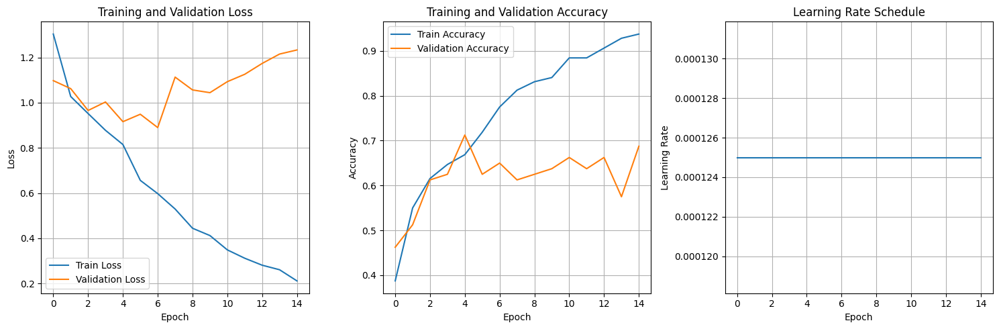

Training completed!
Best validation accuracy: 0.7125
Final train accuracy: 0.9375
Final validation accuracy: 0.6875

Final Validation Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.55      0.63        20
           1       0.58      0.70      0.64        20
           2       0.84      0.80      0.82        20
           3       0.64      0.70      0.67        20

    accuracy                           0.69        80
   macro avg       0.70      0.69      0.69        80
weighted avg       0.70      0.69      0.69        80


TRAINING COMPLETED!
Best Validation Accuracy: 0.7125
Final Training Accuracy: 0.9375
Final Validation Accuracy: 0.6875

Model saved as 'best_mil_model.pth'
Classes mapping: {0: 'Benign', 1: 'InSitu', 2: 'Invasive', 3: 'Normal'}


In [12]:
# Start training the MIL model with your 4-class dataset
if train_loader is not None and val_loader is not None:
    print("Starting training of Attention-guided MIL model with ViT-B16...")
    print(f"Classes: {subdirs}")
    print(f"Training on device: {device}")
    print("=" * 80)
    
    # Training configuration
    num_epochs = 15
    learning_rate = 0.001
    
    # Start training
    results = train_mil_model(
        model=mil_model_4class,
        train_loader=train_loader,
        val_loader=val_loader,
        num_epochs=num_epochs,
        learning_rate=learning_rate
    )
    
    # Print final results
    print("\n" + "=" * 80)
    print("TRAINING COMPLETED!")
    print("=" * 80)
    print(f"Best Validation Accuracy: {results['best_val_acc']:.4f}")
    print(f"Final Training Accuracy: {results['train_accuracies'][-1]:.4f}")
    print(f"Final Validation Accuracy: {results['val_accuracies'][-1]:.4f}")
    
    # Class-wise performance would be shown in the classification report
    print("\nModel saved as 'best_mil_model.pth'")
    print(f"Classes mapping: {dict(enumerate(subdirs))}")
    
else:
    print("Cannot start training: Data loaders not created.")
    print("Please ensure your dataset directories exist and contain images:")
    for i, subdir in enumerate(subdirs):
        dir_path = os.path.join(data_dir, subdir)
        exists = os.path.exists(dir_path)
        print(f"  {i}: {subdir} -> {dir_path} {'✓' if exists else '✗'}")

In [13]:
# ATTENTION INFERENCE AND VISUALIZATION
# Load the trained model and create attention heatmaps for histopathology images

import cv2
from matplotlib.patches import Rectangle
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap

def load_trained_model(model_path='best_mil_model.pth'):
    """
    Load the trained MIL model for inference.
    """
    print(f"Loading trained model from {model_path}...")
    
    # Create model architecture
    inference_model = AttentionMILModel(
        feature_extractor=vit_feature_extractor,
        num_classes=num_classes,
        feature_dim=768,
        hidden_dim=256
    )
    
    # Load trained weights
    checkpoint = torch.load(model_path, map_location=device)
    inference_model.load_state_dict(checkpoint['model_state_dict'])
    inference_model = inference_model.to(device)
    inference_model.eval()
    
    print(f"✓ Model loaded successfully!")
    print(f"✓ Best validation accuracy: {checkpoint['val_acc']:.4f}")
    
    return inference_model

def get_attention_inference(model, image_path, patch_size=224):
    """
    Run inference on a single image and return attention weights with patches.
    
    Args:
        model: Trained MIL model
        image_path: Path to the image
        patch_size: Size of patches (default 224)
        
    Returns:
        prediction, attention_weights, patches, patch_coords, original_image
    """
    # Load and preprocess image
    original_image = Image.open(image_path).convert('RGB')
    
    # Extract patches and coordinates
    patches = extract_patches(original_image, patch_size=patch_size)
    
    # Get patch coordinates for visualization
    image_array = np.array(original_image)
    h, w = image_array.shape[:2]
    
    patch_coords = []
    n_patches_h = (h - patch_size) // patch_size + 1
    n_patches_w = (w - patch_size) // patch_size + 1
    
    for i in range(n_patches_h):
        for j in range(n_patches_w):
            y = i * patch_size
            x = j * patch_size
            if y + patch_size <= h and x + patch_size <= w:
                patch_coords.append((x, y, x + patch_size, y + patch_size))
    
    # Preprocess patches
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                           std=[0.229, 0.224, 0.225])
    ])
    
    patch_tensors = []
    for patch in patches:
        patch_tensor = transform(patch)
        patch_tensors.append(patch_tensor)
    
    if patch_tensors:
        patches_tensor = torch.stack(patch_tensors).unsqueeze(0)  # Add batch dimension
    else:
        patches_tensor = transform(original_image).unsqueeze(0).unsqueeze(0)
    
    # Run inference
    with torch.no_grad():
        predictions, attention_weights = model([patches_tensor.squeeze(0)])
        
        # Get prediction
        predicted_class = torch.argmax(predictions[0]).item()
        confidence = torch.softmax(predictions[0], dim=0)[predicted_class].item()
        
        # Get attention weights
        attention = attention_weights[0].numpy()
    
    return predicted_class, confidence, attention, patches, patch_coords, original_image

print("Attention inference functions created successfully!")
print("Ready to load trained model and perform attention visualization.")

Attention inference functions created successfully!
Ready to load trained model and perform attention visualization.


In [14]:
def visualize_attention_heatmap(original_image, attention_weights, patch_coords, 
                                predicted_class, confidence, class_names, 
                                patch_size=224, save_path=None):
    """
    Create attention heatmap overlay on the original image.
    
    Args:
        original_image: PIL Image
        attention_weights: numpy array of attention weights
        patch_coords: list of (x1, y1, x2, y2) coordinates for each patch
        predicted_class: predicted class index
        confidence: prediction confidence
        class_names: list of class names
        patch_size: size of patches
        save_path: path to save the visualization
    """
    
    # Create figure with subplots
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))
    
    # 1. Original Image
    axes[0].imshow(original_image)
    axes[0].set_title('Original Image', fontsize=14, fontweight='bold')
    axes[0].axis('off')
    
    # 2. Attention Heatmap Overlay
    img_array = np.array(original_image)
    h, w = img_array.shape[:2]
    
    # Create attention heatmap
    attention_map = np.zeros((h, w))
    
    for i, (attention_weight, coord) in enumerate(zip(attention_weights, patch_coords)):
        x1, y1, x2, y2 = coord
        attention_map[y1:y2, x1:x2] = attention_weight
    
    # Normalize attention map
    if attention_map.max() > 0:
        attention_map = (attention_map - attention_map.min()) / (attention_map.max() - attention_map.min())
    
    # Create custom colormap (blue to red)
    colors = ['blue', 'cyan', 'yellow', 'red']
    n_bins = 100
    cmap = LinearSegmentedColormap.from_list('attention', colors, N=n_bins)
    
    # Display original image with attention overlay
    axes[1].imshow(original_image)
    im = axes[1].imshow(attention_map, alpha=0.6, cmap=cmap)
    axes[1].set_title(f'Attention Heatmap\nPredicted: {class_names[predicted_class]} ({confidence:.2f})', 
                     fontsize=14, fontweight='bold')
    axes[1].axis('off')
    
    # Add colorbar
    plt.colorbar(im, ax=axes[1], fraction=0.046, pad=0.04, label='Attention Weight')
    
    # 3. Patch-level Attention Visualization
    axes[2].imshow(original_image)
    
    # Draw rectangles for each patch with attention-based coloring
    for i, (attention_weight, coord) in enumerate(zip(attention_weights, patch_coords)):
        x1, y1, x2, y2 = coord
        
        # Normalize attention weight for coloring
        normalized_attention = attention_weight / attention_weights.max() if attention_weights.max() > 0 else 0
        
        # Color based on attention weight
        color = plt.cm.Reds(normalized_attention)
        
        # Draw rectangle
        rect = Rectangle((x1, y1), x2-x1, y2-y1, 
                        linewidth=2, edgecolor=color, facecolor='none', alpha=0.8)
        axes[2].add_patch(rect)
        
        # Add attention weight text
        if normalized_attention > 0.5:  # Only show text for high attention patches
            axes[2].text(x1 + 10, y1 + 20, f'{attention_weight:.3f}', 
                        color='white', fontweight='bold', fontsize=8,
                        bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.7))
    
    axes[2].set_title('Patch-level Attention\n(Red = High Attention)', 
                     fontsize=14, fontweight='bold')
    axes[2].axis('off')
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Attention visualization saved to: {save_path}")
    
    plt.show()
    
    # Print attention statistics
    print(f"\n📊 Attention Analysis:")
    print(f"Prediction: {class_names[predicted_class]} (Confidence: {confidence:.2f})")
    print(f"Number of patches: {len(attention_weights)}")
    print(f"Max attention weight: {attention_weights.max():.4f}")
    print(f"Min attention weight: {attention_weights.min():.4f}")
    print(f"Mean attention weight: {attention_weights.mean():.4f}")
    print(f"Std attention weight: {attention_weights.std():.4f}")
    
    # Find top attention patches
    top_indices = np.argsort(attention_weights)[-5:][::-1]  # Top 5 patches
    print(f"\n🔍 Top 5 Attention Patches:")
    for i, idx in enumerate(top_indices):
        x1, y1, x2, y2 = patch_coords[idx]
        print(f"  {i+1}. Patch at ({x1}, {y1}) - Attention: {attention_weights[idx]:.4f}")

def show_individual_patches(patches, attention_weights, predicted_class, class_names, top_k=9):
    """
    Display individual patches sorted by attention weights.
    
    Args:
        patches: List of PIL Image patches
        attention_weights: numpy array of attention weights
        predicted_class: predicted class index
        class_names: list of class names
        top_k: number of top patches to display
    """
    
    # Sort patches by attention weights
    sorted_indices = np.argsort(attention_weights)[::-1]  # Descending order
    
    # Create subplot grid
    n_cols = 3
    n_rows = (top_k + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4 * n_rows))
    if n_rows == 1:
        axes = axes.reshape(1, -1)
    
    fig.suptitle(f'Top {top_k} Attention Patches - Predicted: {class_names[predicted_class]}', 
                 fontsize=16, fontweight='bold')
    
    for i in range(top_k):
        row = i // n_cols
        col = i % n_cols
        
        if i < len(sorted_indices):
            idx = sorted_indices[i]
            patch = patches[idx]
            attention = attention_weights[idx]
            
            axes[row, col].imshow(patch)
            axes[row, col].set_title(f'Patch {i+1}\nAttention: {attention:.4f}', 
                                   fontweight='bold')
            axes[row, col].axis('off')
        else:
            axes[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

print("Attention visualization functions created successfully!")
print("Ready to visualize attention heatmaps and individual patches.")

Attention visualization functions created successfully!
Ready to visualize attention heatmaps and individual patches.


In [15]:
# Load the trained model for inference
try:
    # Load the trained model
    trained_model = load_trained_model('best_mil_model.pth')
    
    print("✅ Model loaded successfully for attention inference!")
    print(f"Classes: {subdirs}")
    
except Exception as e:
    print(f"❌ Error loading model: {e}")
    print("Make sure the training was completed and best_mil_model.pth exists.")

Loading trained model from best_mil_model.pth...
✓ Model loaded successfully!
✓ Best validation accuracy: 0.7125
✅ Model loaded successfully for attention inference!
Classes: ['Benign', 'InSitu', 'Invasive', 'Normal']


Running attention analysis on validation samples...
🔍 Running Attention Analysis on Sample Images...

📊 Class: Benign (Index: 0)
----------------------------------------

🖼️  Sample 1: b077.tif
Attention visualization saved to: attention_viz_Benign_sample_1.png


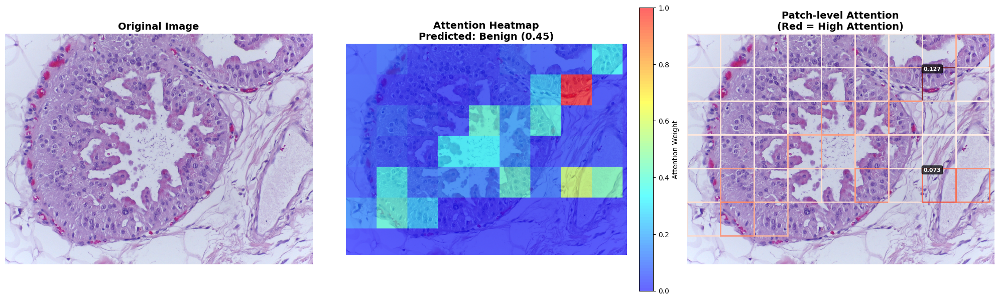


📊 Attention Analysis:
Prediction: Benign (Confidence: 0.45)
Number of patches: 48
Max attention weight: 0.1271
Min attention weight: 0.0017
Mean attention weight: 0.0208
Std attention weight: 0.0241

🔍 Top 5 Attention Patches:
  1. Patch at (1568, 224) - Attention: 0.1271
  2. Patch at (1568, 896) - Attention: 0.0728
  3. Patch at (1792, 896) - Attention: 0.0582
  4. Patch at (1120, 896) - Attention: 0.0527
  5. Patch at (224, 1120) - Attention: 0.0514


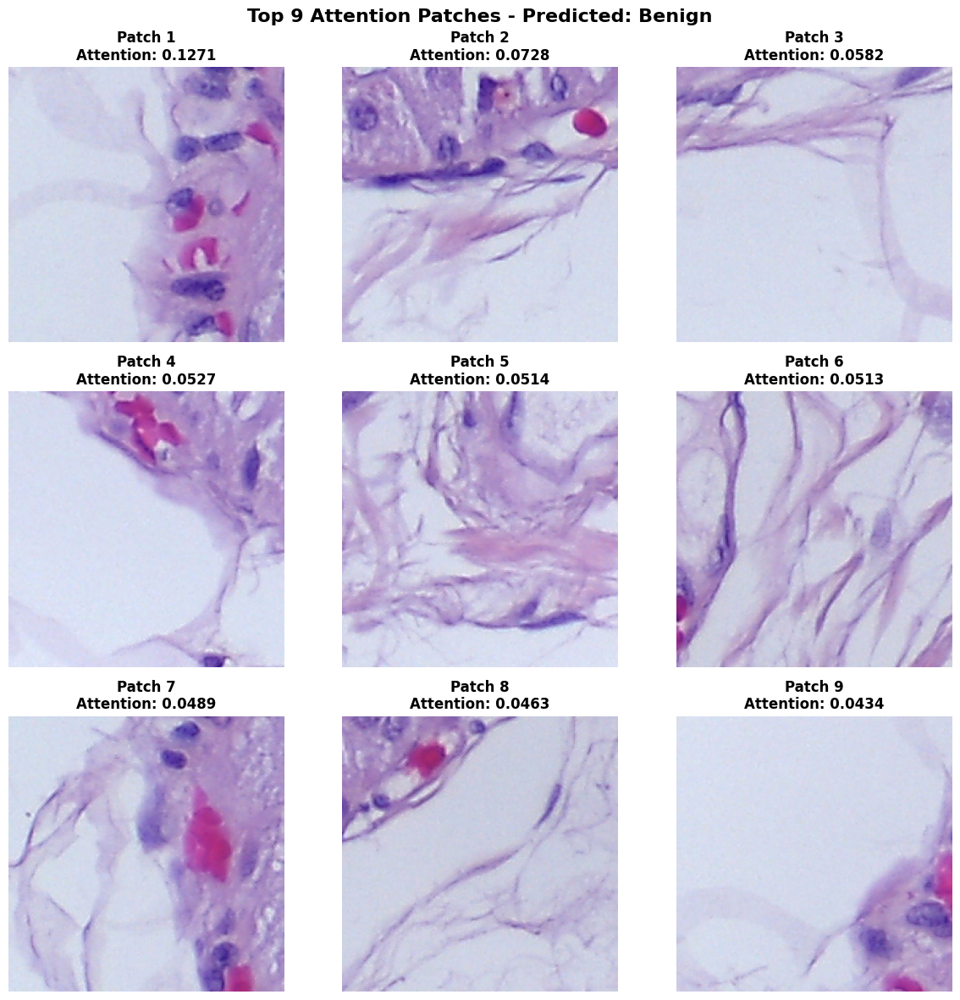

✅ Correct prediction: True
----------------------------------------

🖼️  Sample 2: b070.tif
Attention visualization saved to: attention_viz_Benign_sample_2.png


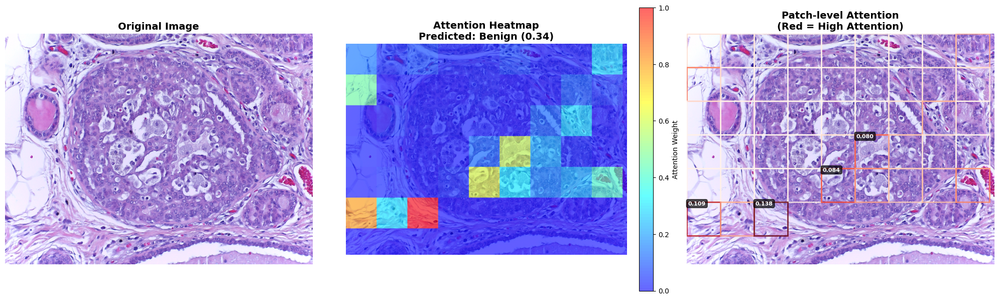


📊 Attention Analysis:
Prediction: Benign (Confidence: 0.34)
Number of patches: 48
Max attention weight: 0.1376
Min attention weight: 0.0015
Mean attention weight: 0.0208
Std attention weight: 0.0300

🔍 Top 5 Attention Patches:
  1. Patch at (448, 1120) - Attention: 0.1376
  2. Patch at (0, 1120) - Attention: 0.1091
  3. Patch at (896, 896) - Attention: 0.0843
  4. Patch at (1120, 672) - Attention: 0.0802
  5. Patch at (0, 224) - Attention: 0.0645


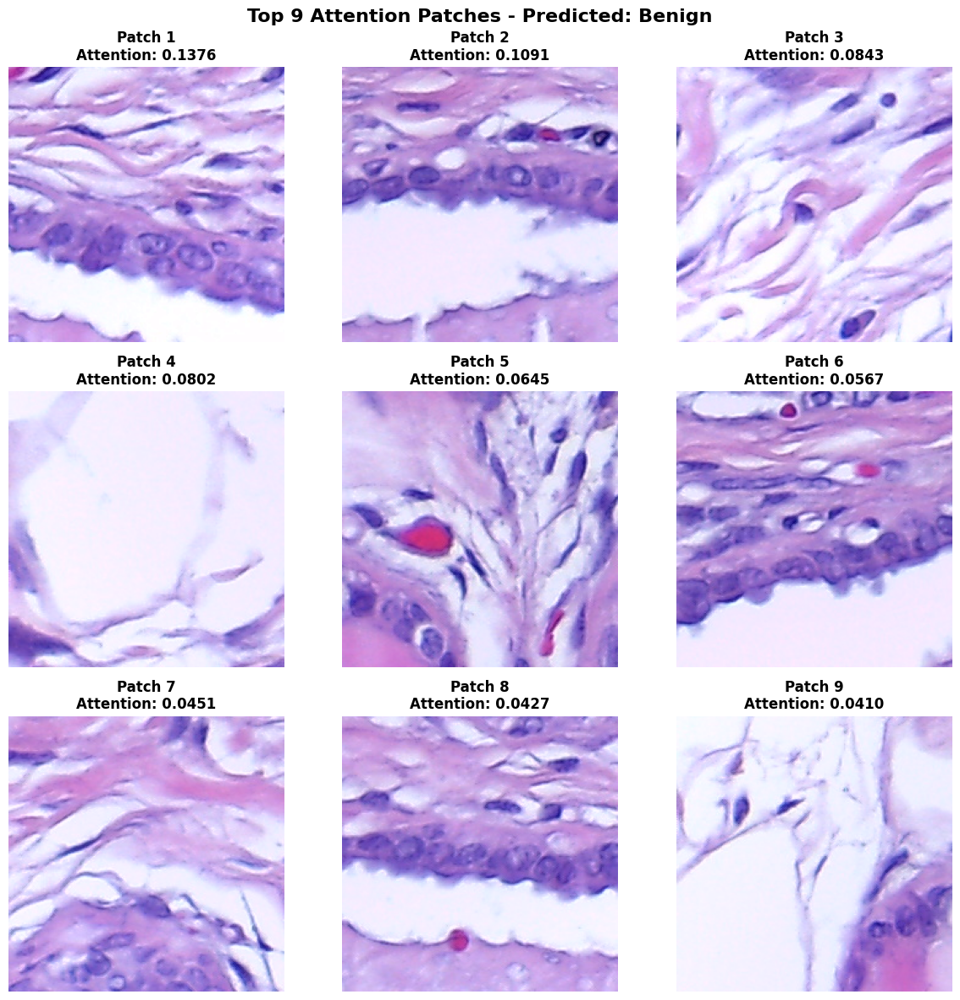

✅ Correct prediction: True
----------------------------------------

📊 Class: InSitu (Index: 1)
----------------------------------------

🖼️  Sample 1: is034.tif
Attention visualization saved to: attention_viz_InSitu_sample_1.png


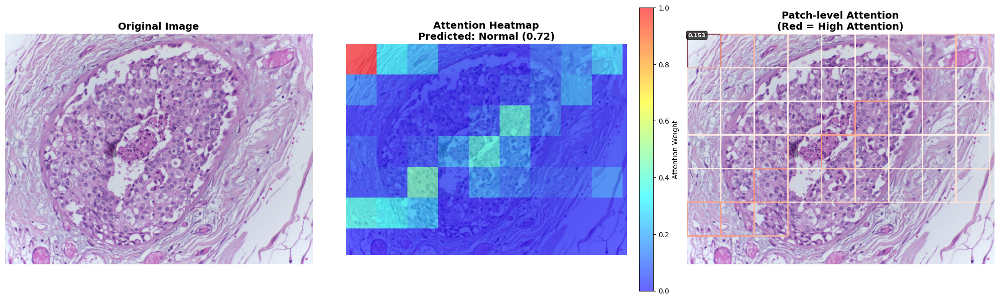


📊 Attention Analysis:
Prediction: Normal (Confidence: 0.72)
Number of patches: 48
Max attention weight: 0.1527
Min attention weight: 0.0012
Mean attention weight: 0.0208
Std attention weight: 0.0265

🔍 Top 5 Attention Patches:
  1. Patch at (0, 0) - Attention: 0.1527
  2. Patch at (448, 896) - Attention: 0.0657
  3. Patch at (1120, 448) - Attention: 0.0603
  4. Patch at (896, 672) - Attention: 0.0582
  5. Patch at (0, 1120) - Attention: 0.0565


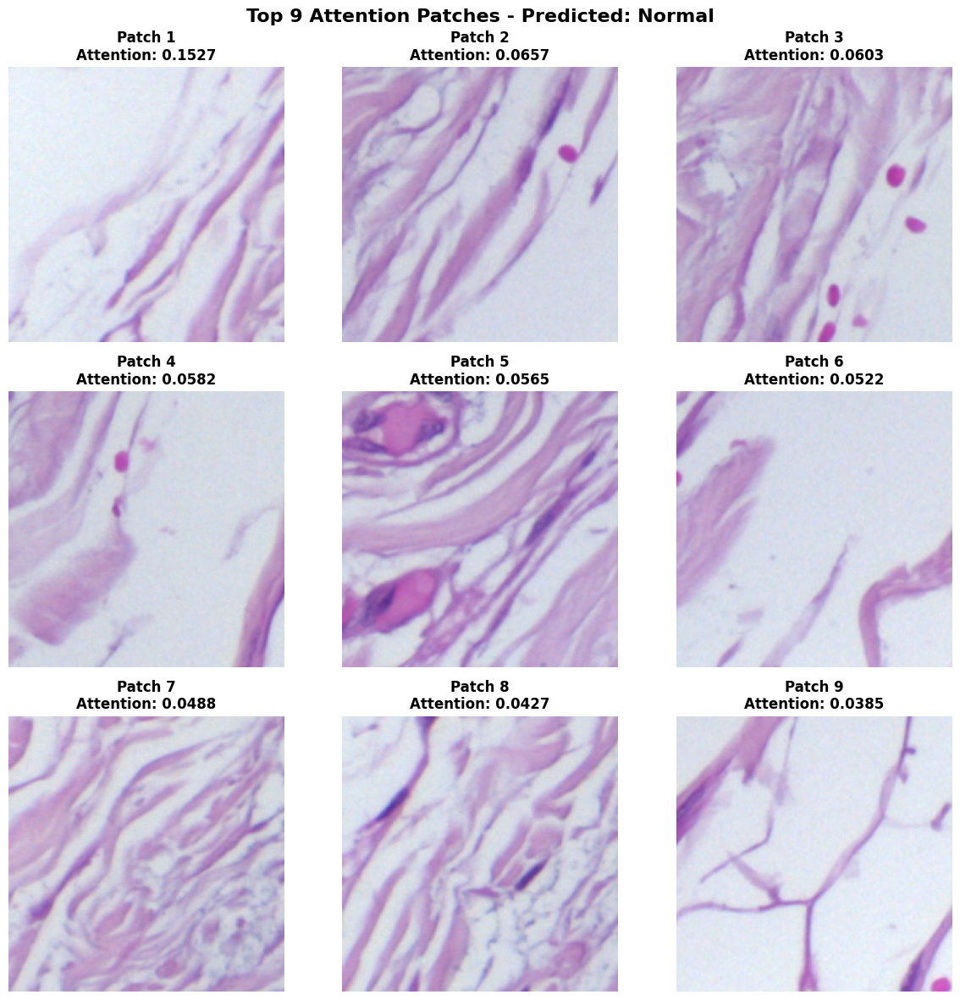

✅ Correct prediction: False
❌ Predicted: Normal, Actual: InSitu
----------------------------------------

🖼️  Sample 2: is007.tif
Attention visualization saved to: attention_viz_InSitu_sample_2.png


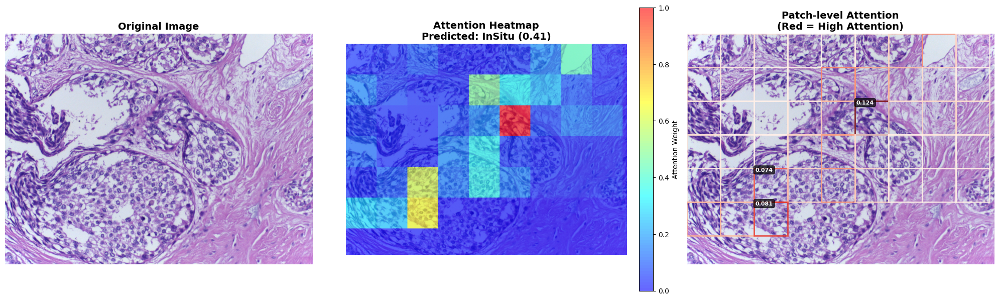


📊 Attention Analysis:
Prediction: InSitu (Confidence: 0.41)
Number of patches: 48
Max attention weight: 0.1237
Min attention weight: 0.0035
Mean attention weight: 0.0208
Std attention weight: 0.0239

🔍 Top 5 Attention Patches:
  1. Patch at (1120, 448) - Attention: 0.1237
  2. Patch at (448, 1120) - Attention: 0.0808
  3. Patch at (448, 896) - Attention: 0.0743
  4. Patch at (896, 224) - Attention: 0.0595
  5. Patch at (1568, 0) - Attention: 0.0540


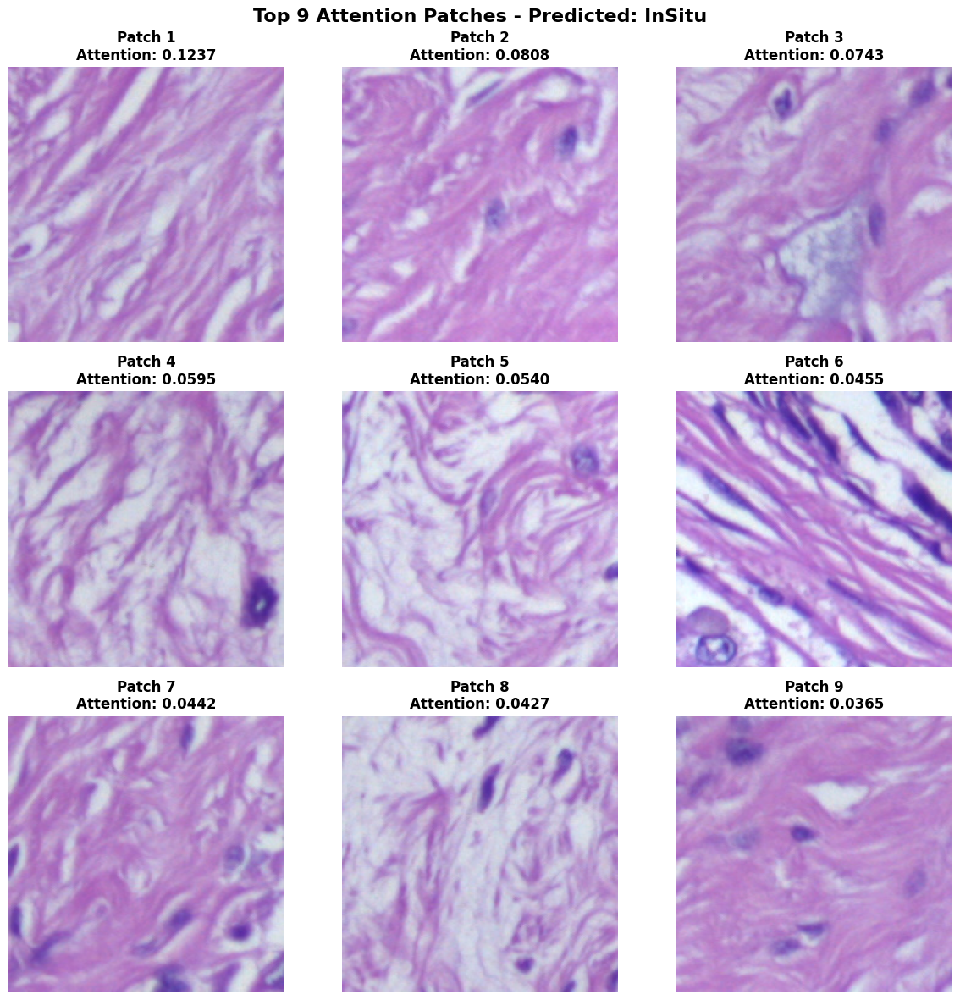

✅ Correct prediction: True
----------------------------------------

📊 Class: Invasive (Index: 2)
----------------------------------------

🖼️  Sample 1: iv013.tif
Attention visualization saved to: attention_viz_Invasive_sample_1.png


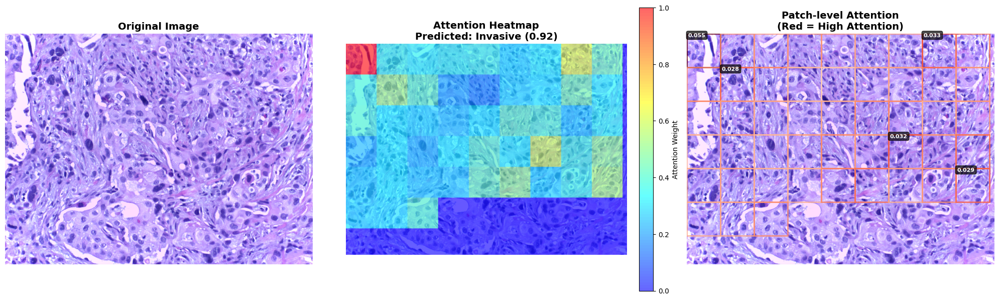


📊 Attention Analysis:
Prediction: Invasive (Confidence: 0.92)
Number of patches: 48
Max attention weight: 0.0549
Min attention weight: 0.0104
Mean attention weight: 0.0208
Std attention weight: 0.0069

🔍 Top 5 Attention Patches:
  1. Patch at (0, 0) - Attention: 0.0549
  2. Patch at (1568, 0) - Attention: 0.0332
  3. Patch at (1344, 672) - Attention: 0.0316
  4. Patch at (1792, 896) - Attention: 0.0289
  5. Patch at (224, 224) - Attention: 0.0285


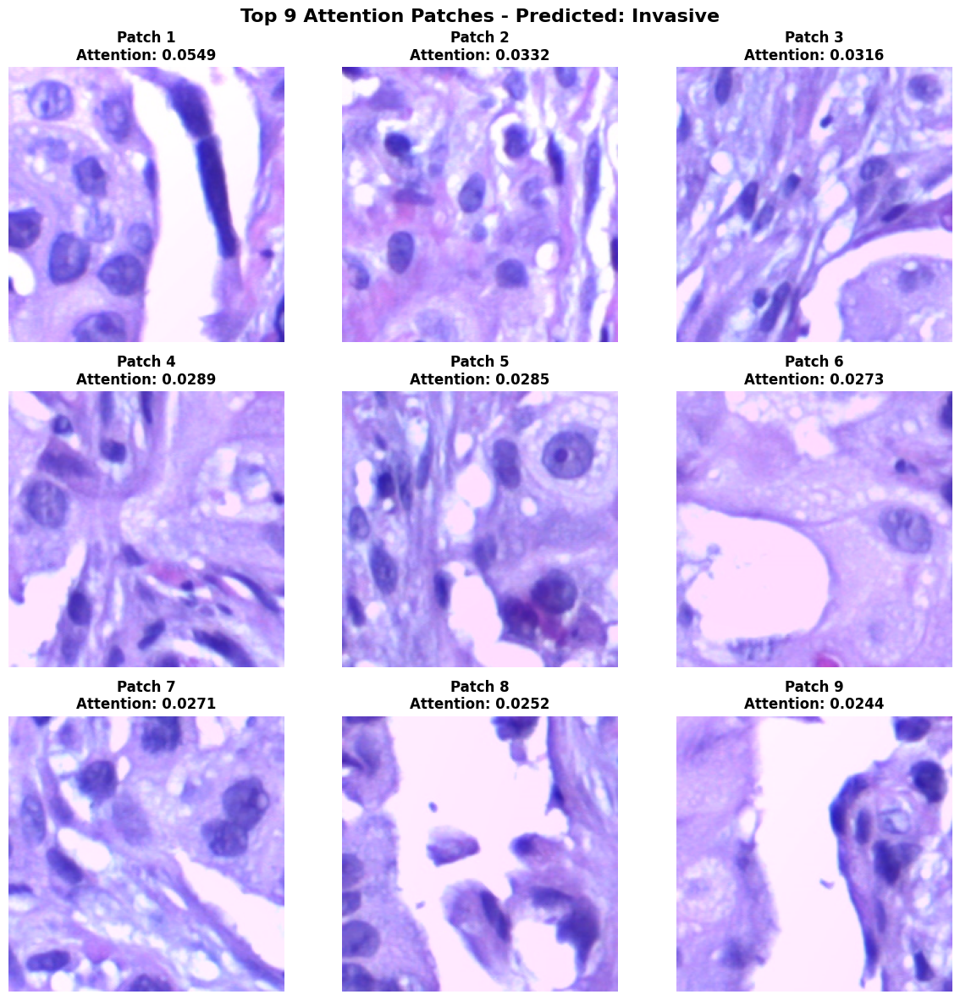

✅ Correct prediction: True
----------------------------------------

🖼️  Sample 2: iv004.tif
Attention visualization saved to: attention_viz_Invasive_sample_2.png


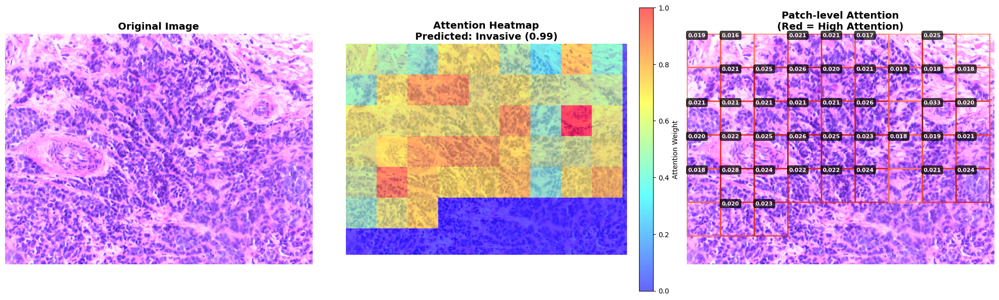


📊 Attention Analysis:
Prediction: Invasive (Confidence: 0.99)
Number of patches: 48
Max attention weight: 0.0330
Min attention weight: 0.0123
Mean attention weight: 0.0208
Std attention weight: 0.0040

🔍 Top 5 Attention Patches:
  1. Patch at (1568, 448) - Attention: 0.0330
  2. Patch at (224, 896) - Attention: 0.0283
  3. Patch at (672, 224) - Attention: 0.0263
  4. Patch at (1120, 448) - Attention: 0.0260
  5. Patch at (672, 672) - Attention: 0.0259


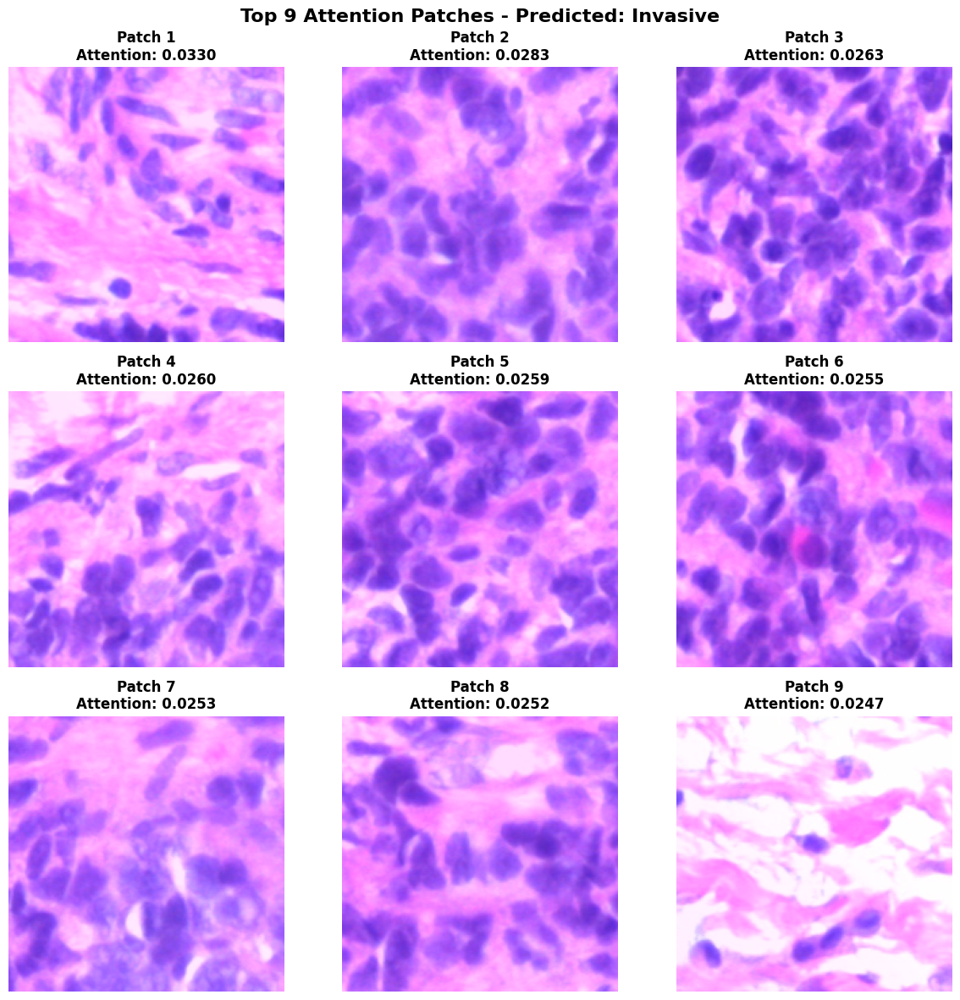

✅ Correct prediction: True
----------------------------------------

📊 Class: Normal (Index: 3)
----------------------------------------

🖼️  Sample 1: n007.tif
Attention visualization saved to: attention_viz_Normal_sample_1.png


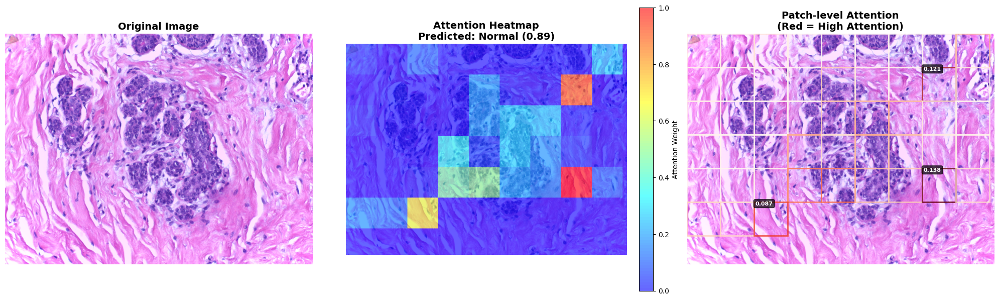


📊 Attention Analysis:
Prediction: Normal (Confidence: 0.89)
Number of patches: 48
Max attention weight: 0.1381
Min attention weight: 0.0007
Mean attention weight: 0.0208
Std attention weight: 0.0304

🔍 Top 5 Attention Patches:
  1. Patch at (1568, 896) - Attention: 0.1381
  2. Patch at (1568, 224) - Attention: 0.1205
  3. Patch at (448, 1120) - Attention: 0.0867
  4. Patch at (896, 896) - Attention: 0.0682
  5. Patch at (672, 896) - Attention: 0.0640


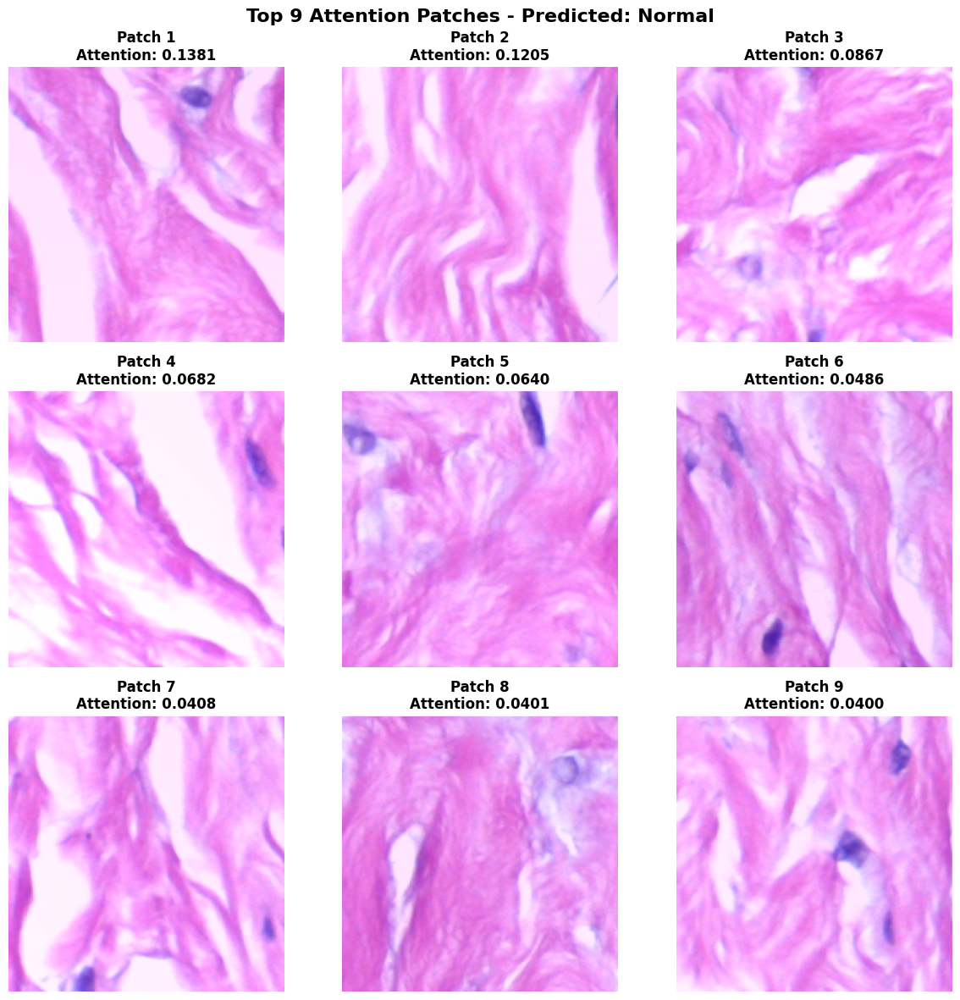

✅ Correct prediction: True
----------------------------------------

🖼️  Sample 2: n073.tif
Attention visualization saved to: attention_viz_Normal_sample_2.png


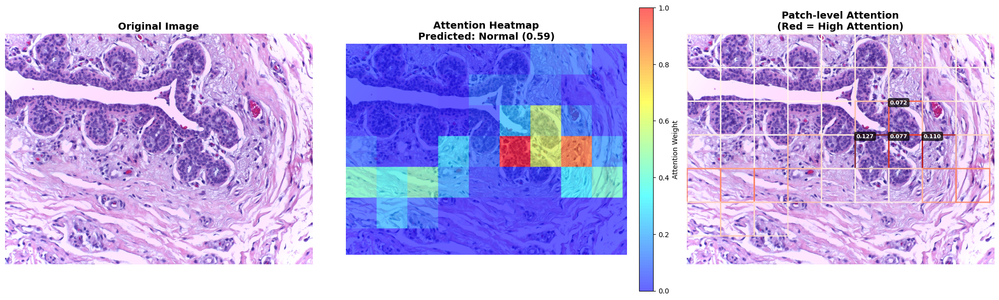


📊 Attention Analysis:
Prediction: Normal (Confidence: 0.59)
Number of patches: 48
Max attention weight: 0.1271
Min attention weight: 0.0008
Mean attention weight: 0.0208
Std attention weight: 0.0284

🔍 Top 5 Attention Patches:
  1. Patch at (1120, 672) - Attention: 0.1271
  2. Patch at (1568, 672) - Attention: 0.1098
  3. Patch at (1344, 672) - Attention: 0.0773
  4. Patch at (1344, 448) - Attention: 0.0721
  5. Patch at (448, 896) - Attention: 0.0576


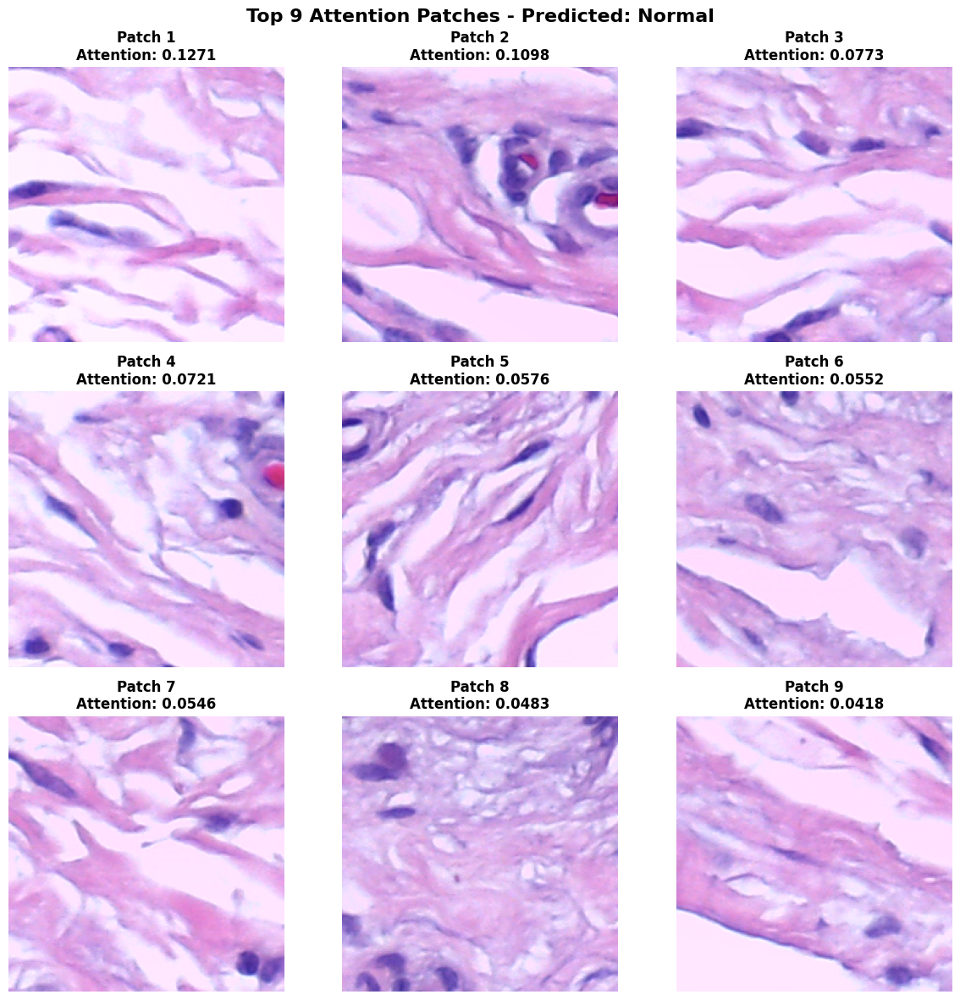

✅ Correct prediction: True
----------------------------------------


In [16]:
# ATTENTION INFERENCE ON SAMPLE IMAGES
# Run attention inference on sample images from each class

def run_attention_analysis_on_samples(model, image_paths, labels, class_names, num_samples_per_class=2):
    """
    Run attention analysis on sample images from each class.
    """
    print("🔍 Running Attention Analysis on Sample Images...")
    print("=" * 60)
    
    # Group images by class
    class_samples = {i: [] for i in range(len(class_names))}
    for path, label in zip(image_paths, labels):
        class_samples[label].append(path)
    
    # Analyze samples from each class
    for class_idx, class_name in enumerate(class_names):
        if class_idx in class_samples and len(class_samples[class_idx]) > 0:
            print(f"\n📊 Class: {class_name} (Index: {class_idx})")
            print("-" * 40)
            
            # Select sample images
            sample_paths = class_samples[class_idx][:num_samples_per_class]
            
            for i, image_path in enumerate(sample_paths):
                print(f"\n🖼️  Sample {i+1}: {image_path.split('/')[-1]}")
                
                try:
                    # Run inference
                    pred_class, confidence, attention, patches, coords, orig_img = get_attention_inference(
                        model, image_path
                    )
                    
                    # Create visualization
                    save_path = f"attention_viz_{class_name}_sample_{i+1}.png"
                    visualize_attention_heatmap(
                        orig_img, attention, coords, pred_class, confidence, 
                        class_names, save_path=save_path
                    )
                    
                    # Show top patches
                    show_individual_patches(patches, attention, pred_class, class_names, top_k=9)
                    
                    # Prediction analysis
                    is_correct = pred_class == class_idx
                    print(f"✅ Correct prediction: {is_correct}")
                    if not is_correct:
                        print(f"❌ Predicted: {class_names[pred_class]}, Actual: {class_name}")
                    
                except Exception as e:
                    print(f"❌ Error processing {image_path}: {e}")
                
                print("-" * 40)

# Run attention analysis if model is loaded
if 'trained_model' in locals():
    # Use validation images for analysis
    print("Running attention analysis on validation samples...")
    run_attention_analysis_on_samples(
        trained_model, 
        val_image_paths, 
        val_labels, 
        subdirs, 
        num_samples_per_class=2
    )
else:
    print("❌ Trained model not loaded. Please run the model loading cell first.")

In [17]:
# INTERACTIVE ATTENTION ANALYSIS
# Analyze specific images with detailed attention visualization

def analyze_single_image(model, image_path, class_names, show_all_patches=False):
    """
    Detailed analysis of a single image with comprehensive visualizations.
    """
    print(f"🔍 Analyzing Image: {image_path}")
    print("=" * 60)
    
    try:
        # Run inference
        pred_class, confidence, attention, patches, coords, orig_img = get_attention_inference(
            model, image_path
        )
        
        # Basic info
        print(f"📊 Image Information:")
        print(f"  Size: {orig_img.size}")
        print(f"  Number of patches: {len(patches)}")
        print(f"  Predicted class: {class_names[pred_class]} (confidence: {confidence:.4f})")
        
        # Create main visualization
        visualize_attention_heatmap(
            orig_img, attention, coords, pred_class, confidence, class_names
        )
        
        # Show top patches
        top_k = 12 if show_all_patches else 9
        show_individual_patches(patches, attention, pred_class, class_names, top_k=top_k)
        
        # Attention statistics
        sorted_attention = np.sort(attention)[::-1]
        
        print(f"\n📈 Detailed Attention Statistics:")
        print(f"  Top 3 attention values: {sorted_attention[:3]}")
        print(f"  Bottom 3 attention values: {sorted_attention[-3:]}")
        print(f"  Attention range: {attention.max() - attention.min():.4f}")
        print(f"  Median attention: {np.median(attention):.4f}")
        
        # Create attention distribution plot
        plt.figure(figsize=(12, 4))
        
        plt.subplot(1, 2, 1)
        plt.hist(attention, bins=20, alpha=0.7, color='skyblue', edgecolor='black')
        plt.axvline(attention.mean(), color='red', linestyle='--', label=f'Mean: {attention.mean():.4f}')
        plt.axvline(np.median(attention), color='green', linestyle='--', label=f'Median: {np.median(attention):.4f}')
        plt.xlabel('Attention Weight')
        plt.ylabel('Frequency')
        plt.title('Distribution of Attention Weights')
        plt.legend()
        plt.grid(True, alpha=0.3)
        
        plt.subplot(1, 2, 2)
        plt.plot(range(len(attention)), sorted_attention, 'o-', color='darkblue', markersize=4)
        plt.xlabel('Patch Rank')
        plt.ylabel('Attention Weight')
        plt.title('Attention Weights (Sorted)')
        plt.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
        
        return pred_class, confidence, attention, patches, coords, orig_img
        
    except Exception as e:
        print(f"❌ Error analyzing image: {e}")
        return None

# Example usage - analyze a specific image
print("Ready for interactive attention analysis!")
print("\nTo analyze a specific image, use:")
print("analyze_single_image(trained_model, 'path/to/your/image.jpg', subdirs)")
print("\nOr run the automated analysis above to see samples from each class.")

Ready for interactive attention analysis!

To analyze a specific image, use:
analyze_single_image(trained_model, 'path/to/your/image.jpg', subdirs)

Or run the automated analysis above to see samples from each class.


Running attention pattern comparison...
🔬 ATTENTION PATTERN COMPARISON ACROSS CLASSES

📊 Analyzing Benign samples...

📊 Analyzing InSitu samples...

📊 Analyzing Invasive samples...

📊 Analyzing Normal samples...


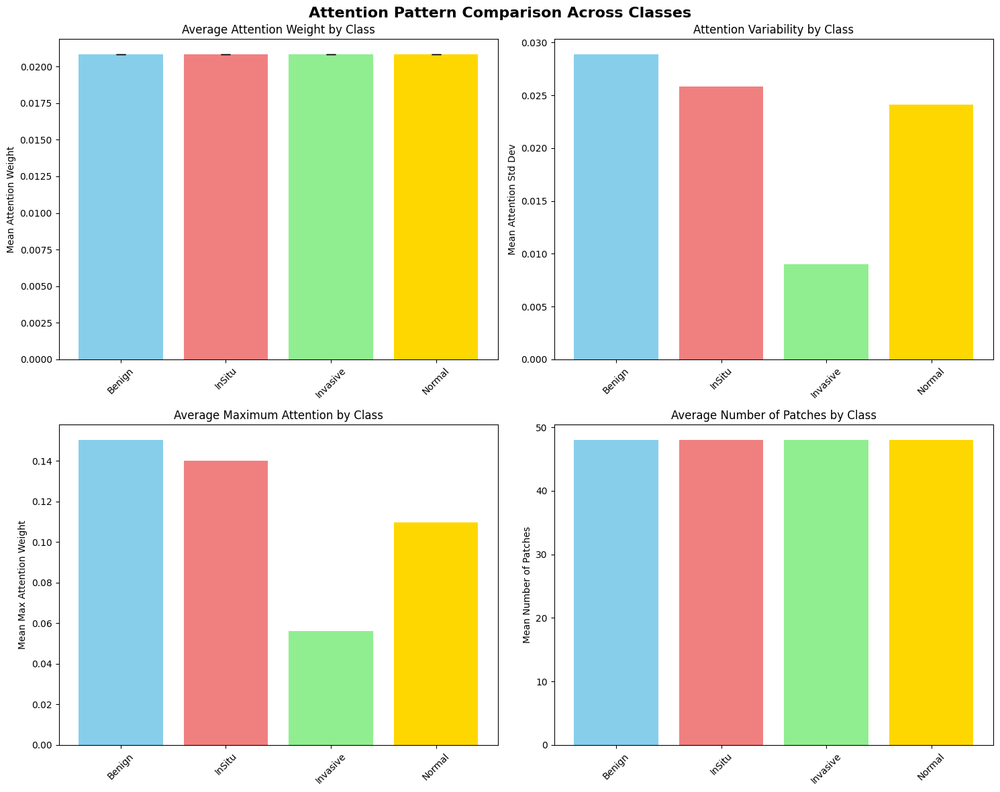


📈 DETAILED ATTENTION STATISTICS BY CLASS:

🏷️  Benign:
   Mean attention: 0.0208 ± 0.0000
   Attention variability: 0.0289
   Max attention: 0.1502
   Avg patches per image: 48.0
   Samples analyzed: 3

🏷️  InSitu:
   Mean attention: 0.0208 ± 0.0000
   Attention variability: 0.0258
   Max attention: 0.1401
   Avg patches per image: 48.0
   Samples analyzed: 3

🏷️  Invasive:
   Mean attention: 0.0208 ± 0.0000
   Attention variability: 0.0090
   Max attention: 0.0562
   Avg patches per image: 48.0
   Samples analyzed: 3

🏷️  Normal:
   Mean attention: 0.0208 ± 0.0000
   Attention variability: 0.0241
   Max attention: 0.1097
   Avg patches per image: 48.0
   Samples analyzed: 3


In [18]:
# ATTENTION COMPARISON ACROSS CLASSES
# Compare attention patterns across different classes

def compare_attention_across_classes(model, image_paths, labels, class_names, samples_per_class=3):
    """
    Compare attention patterns across different classes.
    """
    print("🔬 ATTENTION PATTERN COMPARISON ACROSS CLASSES")
    print("=" * 70)
    
    # Collect attention statistics for each class
    class_attention_stats = {class_name: {'attention_means': [], 'attention_stds': [], 
                                         'attention_maxes': [], 'num_patches': []} 
                            for class_name in class_names}
    
    # Group images by class
    class_samples = {i: [] for i in range(len(class_names))}
    for path, label in zip(image_paths, labels):
        class_samples[label].append(path)
    
    # Analyze samples from each class
    for class_idx, class_name in enumerate(class_names):
        if class_idx in class_samples and len(class_samples[class_idx]) > 0:
            print(f"\n📊 Analyzing {class_name} samples...")
            
            sample_paths = class_samples[class_idx][:samples_per_class]
            
            for image_path in sample_paths:
                try:
                    pred_class, confidence, attention, patches, coords, orig_img = get_attention_inference(
                        model, image_path
                    )
                    
                    # Store statistics
                    class_attention_stats[class_name]['attention_means'].append(attention.mean())
                    class_attention_stats[class_name]['attention_stds'].append(attention.std())
                    class_attention_stats[class_name]['attention_maxes'].append(attention.max())
                    class_attention_stats[class_name]['num_patches'].append(len(attention))
                    
                except Exception as e:
                    print(f"Error processing {image_path}: {e}")
    
    # Create comparison visualizations
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    fig.suptitle('Attention Pattern Comparison Across Classes', fontsize=16, fontweight='bold')
    
    # 1. Mean Attention by Class
    means_by_class = [np.mean(class_attention_stats[class_name]['attention_means']) 
                     for class_name in class_names]
    stds_by_class = [np.std(class_attention_stats[class_name]['attention_means']) 
                    for class_name in class_names]
    
    axes[0, 0].bar(class_names, means_by_class, yerr=stds_by_class, capsize=5, 
                   color=['skyblue', 'lightcoral', 'lightgreen', 'gold'])
    axes[0, 0].set_title('Average Attention Weight by Class')
    axes[0, 0].set_ylabel('Mean Attention Weight')
    axes[0, 0].tick_params(axis='x', rotation=45)
    
    # 2. Attention Variability by Class
    variability_by_class = [np.mean(class_attention_stats[class_name]['attention_stds']) 
                           for class_name in class_names]
    
    axes[0, 1].bar(class_names, variability_by_class, 
                   color=['skyblue', 'lightcoral', 'lightgreen', 'gold'])
    axes[0, 1].set_title('Attention Variability by Class')
    axes[0, 1].set_ylabel('Mean Attention Std Dev')
    axes[0, 1].tick_params(axis='x', rotation=45)
    
    # 3. Max Attention by Class
    max_attention_by_class = [np.mean(class_attention_stats[class_name]['attention_maxes']) 
                             for class_name in class_names]
    
    axes[1, 0].bar(class_names, max_attention_by_class, 
                   color=['skyblue', 'lightcoral', 'lightgreen', 'gold'])
    axes[1, 0].set_title('Average Maximum Attention by Class')
    axes[1, 0].set_ylabel('Mean Max Attention Weight')
    axes[1, 0].tick_params(axis='x', rotation=45)
    
    # 4. Number of Patches by Class
    patches_by_class = [np.mean(class_attention_stats[class_name]['num_patches']) 
                       for class_name in class_names]
    
    axes[1, 1].bar(class_names, patches_by_class, 
                   color=['skyblue', 'lightcoral', 'lightgreen', 'gold'])
    axes[1, 1].set_title('Average Number of Patches by Class')
    axes[1, 1].set_ylabel('Mean Number of Patches')
    axes[1, 1].tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()
    
    # Print detailed statistics
    print(f"\n📈 DETAILED ATTENTION STATISTICS BY CLASS:")
    print("=" * 50)
    
    for class_name in class_names:
        stats = class_attention_stats[class_name]
        if stats['attention_means']:
            print(f"\n🏷️  {class_name}:")
            print(f"   Mean attention: {np.mean(stats['attention_means']):.4f} ± {np.std(stats['attention_means']):.4f}")
            print(f"   Attention variability: {np.mean(stats['attention_stds']):.4f}")
            print(f"   Max attention: {np.mean(stats['attention_maxes']):.4f}")
            print(f"   Avg patches per image: {np.mean(stats['num_patches']):.1f}")
            print(f"   Samples analyzed: {len(stats['attention_means'])}")
    
    return class_attention_stats

# Run comparison analysis if model is available
if 'trained_model' in locals():
    print("Running attention pattern comparison...")
    attention_comparison = compare_attention_across_classes(
        trained_model, val_image_paths, val_labels, subdirs, samples_per_class=3
    )
else:
    print("❌ Trained model not loaded. Please run the model loading cell first.")